In [1]:
library(rstan)
# sessionInfo()

# https://github.com/stan-dev/rstan/wiki/RStan-Getting-Started-(Japanese)
#　このページに書いてあるRstanの例をやってみた

Loading required package: ggplot2
Loading required package: StanHeaders
rstan (Version 2.10.1, packaged: 2016-06-24 13:22:16 UTC, GitRev: 85f7a56811da)
For execution on a local, multicore CPU with excess RAM we recommend calling
rstan_options(auto_write = TRUE)
options(mc.cores = parallel::detectCores())


In [2]:
# stanフィアルをとってきて保存する
require("RCurl")
url <- getURL("https://raw.githubusercontent.com/wiki/stan-dev/rstan/8schools.stan")
write (url, "8schools.stan")

Loading required package: RCurl
Loading required package: bitops


In [3]:
schools_dat <- list(J = 8,
                    y = c(28,  8, -3,  7, -1,  1, 18, 12),
                    sigma = c(15, 10, 16, 11,  9, 11, 10, 18))

fit <- stan(file = '8schools.stan', data = schools_dat,
            iter = 1000, chains = 4)


SAMPLING FOR MODEL '8schools' NOW (CHAIN 1).

Chain 1, Iteration:   1 / 1000 [  0%]  (Warmup)
Chain 1, Iteration: 100 / 1000 [ 10%]  (Warmup)
Chain 1, Iteration: 200 / 1000 [ 20%]  (Warmup)
Chain 1, Iteration: 300 / 1000 [ 30%]  (Warmup)
Chain 1, Iteration: 400 / 1000 [ 40%]  (Warmup)
Chain 1, Iteration: 500 / 1000 [ 50%]  (Warmup)
Chain 1, Iteration: 501 / 1000 [ 50%]  (Sampling)
Chain 1, Iteration: 600 / 1000 [ 60%]  (Sampling)
Chain 1, Iteration: 700 / 1000 [ 70%]  (Sampling)
Chain 1, Iteration: 800 / 1000 [ 80%]  (Sampling)
Chain 1, Iteration: 900 / 1000 [ 90%]  (Sampling)
Chain 1, Iteration: 1000 / 1000 [100%]  (Sampling)
 Elapsed Time: 0.017809 seconds (Warm-up)
               0.012797 seconds (Sampling)
               0.030606 seconds (Total)


SAMPLING FOR MODEL '8schools' NOW (CHAIN 2).

Chain 2, Iteration:   1 / 1000 [  0%]  (Warmup)
Chain 2, Iteration: 100 / 1000 [ 10%]  (Warmup)
Chain 2, Iteration: 200 / 1000 [ 20%]  (Warmup)
Chain 2, Iteration: 300 / 1000 [ 30%]  (Warmup)

Inference for Stan model: 8schools.
4 chains, each with iter=1000; warmup=500; thin=1; 
post-warmup draws per chain=500, total post-warmup draws=2000.

          mean se_mean   sd   2.5%   25%   50%   75% 97.5% n_eff Rhat
mu        7.78    0.21 5.15  -2.01  4.47  7.69 10.81 18.50   577 1.01
tau       6.25    0.23 5.56   0.20  2.13  4.77  8.76 20.82   598 1.00
eta[1]    0.42    0.02 0.94  -1.50 -0.16  0.43  1.05  2.24  1536 1.00
eta[2]   -0.02    0.02 0.90  -1.75 -0.58 -0.02  0.53  1.83  1691 1.00
eta[3]   -0.19    0.03 0.91  -1.96 -0.78 -0.20  0.42  1.58  1187 1.00
eta[4]    0.00    0.02 0.89  -1.75 -0.58  0.01  0.56  1.80  1395 1.00
eta[5]   -0.33    0.03 0.90  -1.99 -0.93 -0.37  0.23  1.56  1018 1.00
eta[6]   -0.18    0.02 0.88  -1.79 -0.77 -0.18  0.37  1.63  1382 1.00
eta[7]    0.39    0.02 0.87  -1.42 -0.15  0.39  0.96  2.04  1352 1.00
eta[8]    0.07    0.02 0.89  -1.68 -0.53  0.05  0.68  1.78  1667 1.00
theta[1] 11.37    0.30 8.43  -1.66  5.87 10.02 15.56 32.42   773 1.00
theta[2]

'pars' not specified. Showing first 10 parameters by default.
ci_level: 0.8 (80% intervals)
outer_level: 0.95 (95% intervals)


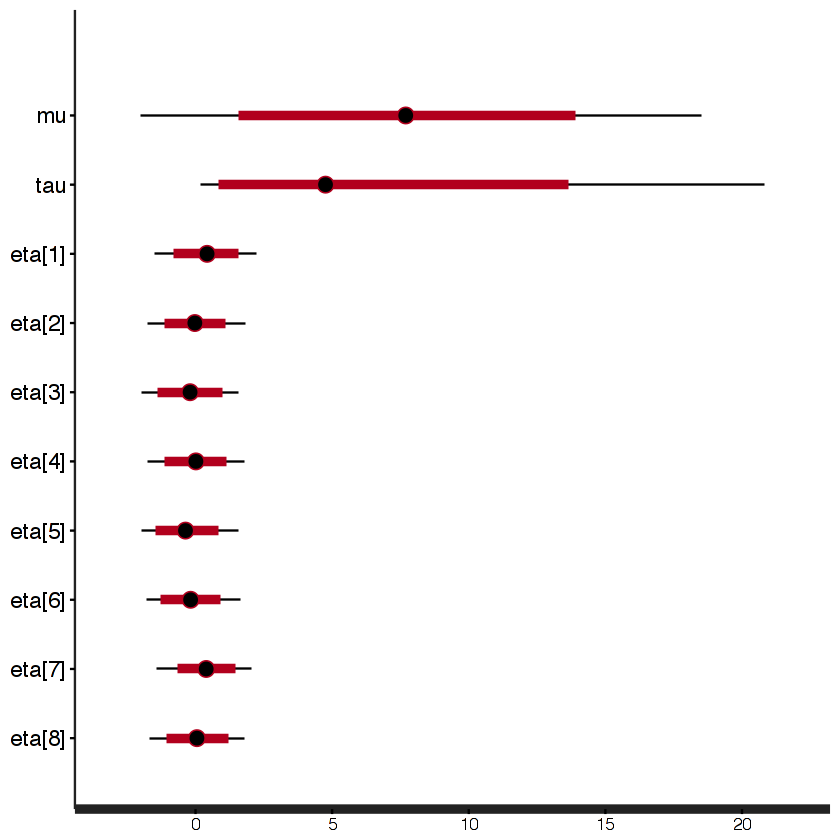

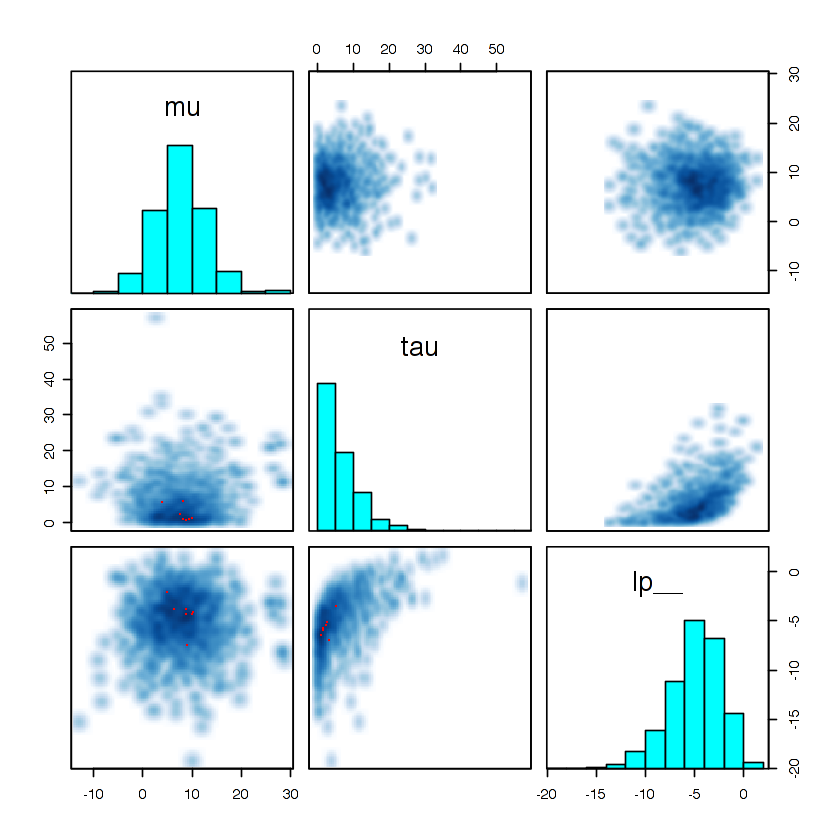

In [5]:
print(fit)
plot(fit)
pairs(fit, pars = c("mu", "tau", "lp__"))

la <- extract(fit, permuted = TRUE) # arraysのlistを返す
mu <- la$mu

### iterations, chains, parametersの3次元arrayを返す
a <- extract(fit, permuted = FALSE)

### stanfitオブジェクトにS3関数のas.array（やas.matrix）を使う
a2 <- as.array(fit)
m <- as.matrix(fit)

'pars' not specified. Showing first 10 parameters by default.


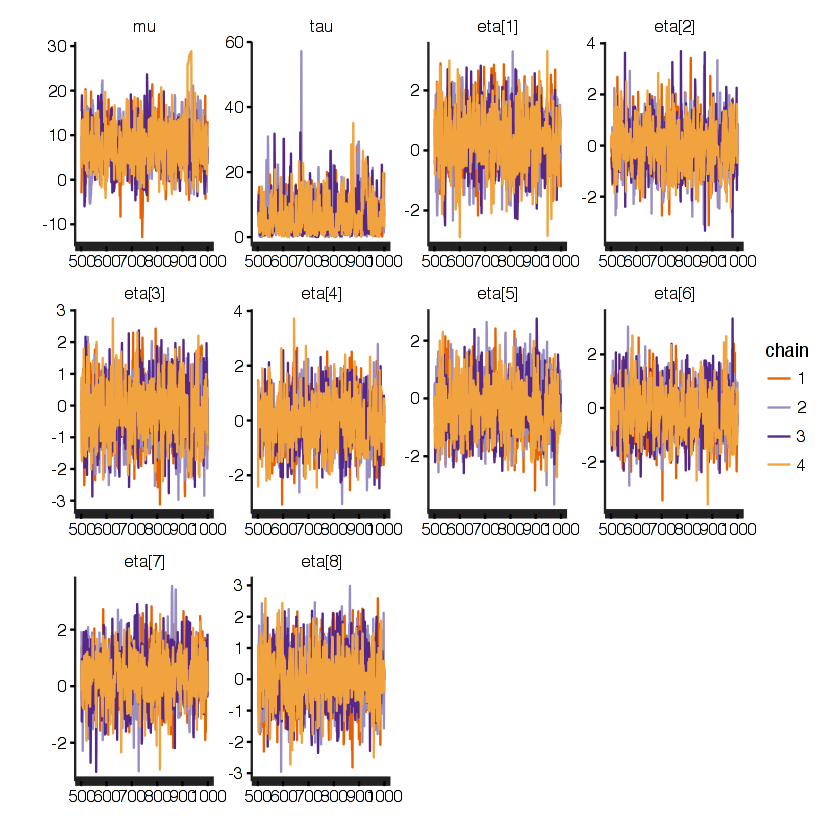

In [4]:
traceplot(fit )